# Загрузка данных, расчет доходностей
Источники:

В статье
  - https://www.crsp.org/research/crsp-us-stock-databases/ (можно попробовать сделать запрос для получения данных)
  - https://mba.tuck.dartmouth.edu/pages/faculty/ken.french/data_library.html s include the market return (MKT), size (SMB), value (HML), profitability (RMW), investment (CMA), and momentumn (MOM)  (пока не понял зачем, возмонжно, для портфолио, использование CAPM

Начнем со скачивания данных с yahoofinance



In [1]:
!pip install yfinance -q
import yfinance as yf
import bs4 as bs
import numpy as np
import pandas as pd
import scipy.stats as stats
import os
import requests
from datetime import datetime
from pandas.core.frame import DataFrame

In [2]:
# названия тикеров с сайта
resp = requests.get('https://stockanalysis.com/list/sp-500-stocks/')

soup = bs.BeautifulSoup(resp.text, 'lxml')
table = soup.find('table')
tickers = []
for row in table.findAll('tr')[1:]:
    ticker = row.findAll('td')[1].text
    tickers.append(ticker)
tickers = [s.replace('\n', '') for s in tickers]
# tickers = tickers + ["SPY"]

/tmp/ipython-input-2896327659.py:7: DeprecationWarning: Call to deprecated method findAll. (Replaced by find_all) -- Deprecated since version 4.0.0.
  for row in table.findAll('tr')[1:]:
/tmp/ipython-input-2896327659.py:8: DeprecationWarning: Call to deprecated method findAll. (Replaced by find_all) -- Deprecated since version 4.0.0.
  ticker = row.findAll('td')[1].text


In [3]:
tickers[:3]

['NVDA', 'AAPL', 'GOOG']

$$r_{i,t}^{close-to-close} = P_{i,t}^{Adj close}/P_{i,t-1}^{Adj close} -1$$
$$r_{i,t}^{daytime} = P_{i,t}^{close}/P_{i,t}^{open} -1$$
$$r_{i,t}^{overnight} = (1+ r_{i,t}^{close-to-close})/(1+r_{i,t}^{daytime}) -1$$

$$ρ_{i, j}^{overnight-lead-daytime} = Pearson.corr(r_{i,t}^{overnight}, r_{j,t}^{daytime})$$

$$ρ_{i, j}^{daytime-lead-overnight} = Pearson.corr(r_{i,t-1}^{daytime}, r_{j,t}^{overnight})$$


In [ ]:
def download_prices(tickers, start_date, end_date):
    # Загружаем все данные сразу
    data = yf.download(tickers, start=start_date, end=end_date, auto_adjust=False)

    returns_data = {}

    for ticker in tickers:
      df = pd.DataFrame({
          'close': data['Close'][ticker],
          'open': data['Open'][ticker],
          'adj_close': data['Adj Close'][ticker]
      }).dropna()

      # Расчет доходностей
      df['close_to_close'] = df['adj_close'] / df['adj_close'].shift(1) - 1
      df['daytime'] = df['close'] / df['open'] - 1
      df['overnight'] = (1 + df['close_to_close']) / (1 + df['daytime']) - 1

      df['ticker'] = ticker
      returns_data[ticker] = df[['close_to_close', 'daytime', 'overnight', 'ticker']]

    # Объединяем все данные
    all_returns = pd.concat(returns_data.values())
    return all_returns.reset_index().rename(columns={'index': 'date'})

returns_df = download_prices(tickers, '2020-01-01', '2024-12-31')

returns_df.to_parquet('/content/drive/MyDrive/Диплом_магистртура/data.parquet')

[*********************100%***********************]  503 of 503 completed
ERROR:yfinance:
4 Failed downloads:
ERROR:yfinance:['SOLS', 'Q']: YFPricesMissingError('possibly delisted; no price data found  (1d 2020-01-01 -> 2024-12-31) (Yahoo error = "Data doesn\'t exist for startDate = 1577854800, endDate = 1735621200")')
ERROR:yfinance:['BF.B']: YFPricesMissingError('possibly delisted; no price data found  (1d 2020-01-01 -> 2024-12-31)')
ERROR:yfinance:['BRK.B']: YFTzMissingError('possibly delisted; no timezone found')


In [4]:
returns_df = pd.read_parquet('/content/drive/MyDrive/Диплом_магистртура/data.parquet', engine='pyarrow')

In [5]:
returns_df

,Date,close_to_close,daytime,overnight,ticker
0,2020-01-02,NaN,0.004859,NaN,NVDA
1,2020-01-03,-0.016006,0.004126,-0.020049,NVDA
2,2020-01-06,0.004194,0.020403,-0.015885,NVDA
3,2020-01-07,0.012107,0.007263,0.004809,NVDA
4,2020-01-08,0.001876,0.002586,-0.000708,NVDA
...,...,...,...,...,...
619974,2024-12-23,0.003189,0.013051,-0.009735,MHK
619975,2024-12-24,0.005438,0.013834,-0.008282,MHK
619976,2024-12-26,-0.004410,0.006392,-0.010733,MHK
619977,2024-12-27,-0.007020,0.002108,-0.009109,MHK


# Матрицы корреляций


In [7]:
# Функция для расчета матриц корреляции
def calculate_correlations(data, tickers, lookback_days=60):
    data = data.copy()
    data['Date'] = pd.to_datetime(data['Date'])

    # Берем последние lookback_days дней
    all_dates = sorted(data['Date'].unique())
    end_date = all_dates[-1]
    start_date = all_dates[-lookback_days]

    window_data = data[(data['Date'] >= start_date) & (data['Date'] <= end_date)]

    n = len(tickers)
    corr_overnight_daytime = np.full((n, n), np.nan)
    corr_daytime_overnight = np.full((n, n), np.nan)

    overnight_pivot = window_data.pivot(index='Date', columns='ticker', values='overnight')
    daytime_pivot = window_data.pivot(index='Date', columns='ticker', values='daytime')

    for i in range(n):
        for j in range(n):
            ticker_i = tickers[i]
            ticker_j = tickers[j]

            # 1. Overnight_i -> Daytime_j
            df_ol_dt = pd.DataFrame({
                'overnight': overnight_pivot[ticker_i],
                'daytime': daytime_pivot[ticker_j]
            }).dropna()


            corr_ol_dt = stats.pearsonr(df_ol_dt['overnight'], df_ol_dt['daytime'])[0]
            corr_overnight_daytime[i,j] = corr_ol_dt

            # 2. Daytime_i -> Overnight_j (со сдвигом)
            df_dt_ol = pd.DataFrame({
                'daytime_shifted': daytime_pivot[ticker_i].shift(1),  # Сдвиг на 1 день
                'overnight': overnight_pivot[ticker_j]
            }).dropna()


            corr_dt_ol = stats.pearsonr(df_dt_ol['daytime_shifted'], df_dt_ol['overnight'])[0]
            corr_daytime_overnight[i,j] = corr_dt_ol

    return corr_overnight_daytime, corr_daytime_overnight

# Тест
tickers_subset = ['NVDA', 'AAPL', 'MSFT', 'GOOGL', 'AMZN']
corr_overnight_daytime, corr_daytime_overnight = calculate_correlations(returns_df, tickers_subset)

print("Overnight-Lead-Daytime:")
print(pd.DataFrame(corr_overnight_daytime, index=tickers_subset, columns=tickers_subset).round(4))

print("\nDaytime-Lead-Overnight:")
print(pd.DataFrame(corr_daytime_overnight, index=tickers_subset, columns=tickers_subset).round(4))

Overnight-Lead-Daytime:
         NVDA    AAPL    MSFT   GOOGL    AMZN
NVDA  -0.0059 -0.1083 -0.0236 -0.0228  0.0948
AAPL  -0.1613  0.0046  0.0872  0.0158  0.1918
MSFT   0.0113  0.0818  0.0761 -0.1134  0.1012
GOOGL -0.1121 -0.1680 -0.1020 -0.1346 -0.0015
AMZN  -0.0451  0.1363  0.1292  0.0611  0.0192

Daytime-Lead-Overnight:
         NVDA    AAPL    MSFT   GOOGL    AMZN
NVDA  -0.0223  0.1896  0.0341  0.0433 -0.2546
AAPL  -0.0677  0.0171 -0.0300  0.0733 -0.2698
MSFT  -0.2544  0.1427  0.0525  0.1042 -0.2629
GOOGL -0.1945  0.1297  0.2408  0.1397 -0.0690
AMZN  -0.1982  0.1358  0.0518  0.0569 -0.1778


## Анализ корреляций

In [ ]:
# Как связи анализировать, как ночные дневные сети, если они расчитываются на каждый день
import matplotlib.pyplot as plt
import networkx as nx
from plotly.subplots import make_subplots
import plotly.graph_objects as go
import plotly.express as px

In [8]:
tickers = returns_df['ticker'].unique()

=== LEAD-LAG ANALYSIS STARTING ===
=== 📊 COMPREHENSIVE LEAD-LAG ANALYSIS ===

🌡️ CORRELATION HEATMAPS



📈 MATRIX STATISTICS:
Overnight-Lead-Daytime:
  Mean: -0.0096
  Max:  0.8126
  Min:  -0.7466
  Std:  0.1536
Daytime-Lead-Overnight:
  Mean: 0.0034
  Max:  0.8258
  Min:  -0.7596
  Std:  0.1365

🌐 NETWORK ANALYSIS (threshold: 0.1)

--- Overnight-Lead-Daytime ---


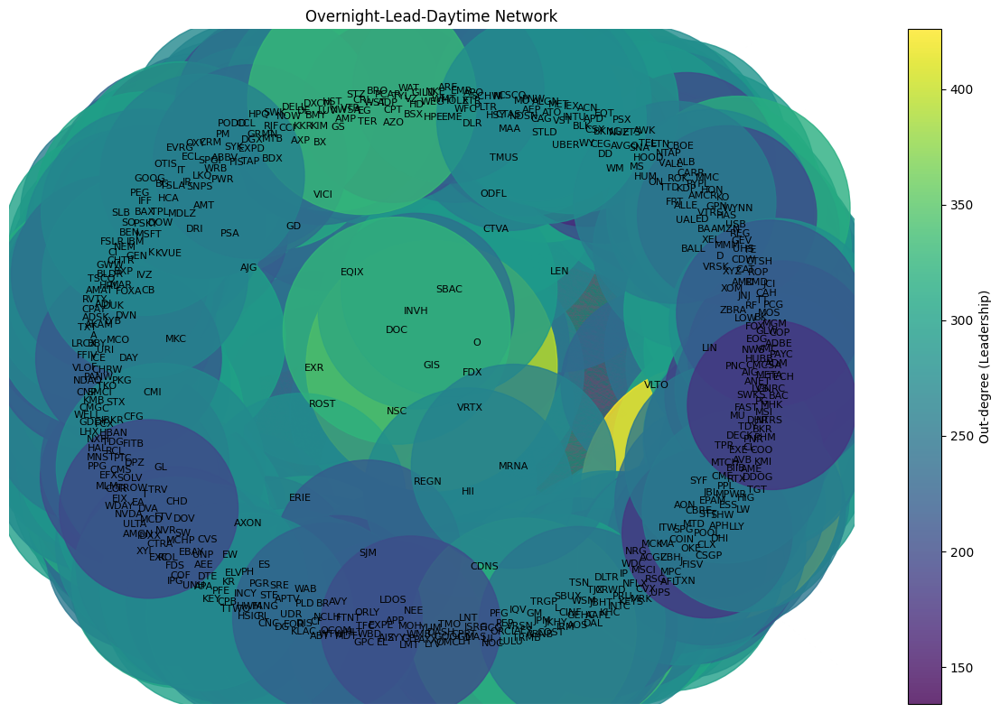

  Nodes: 499
  Edges: 124701
  Density: 0.5018
  Top Leaders: ['JBL(426)', 'GIS(397)', 'BRO(338)', 'FANG(335)', 'WFC(334)']
  Top Laggers: ['TRMB(413)', 'JKHY(412)', 'ORLY(401)', 'PM(398)', 'IFF(397)']

--- Daytime-Lead-Overnight ---


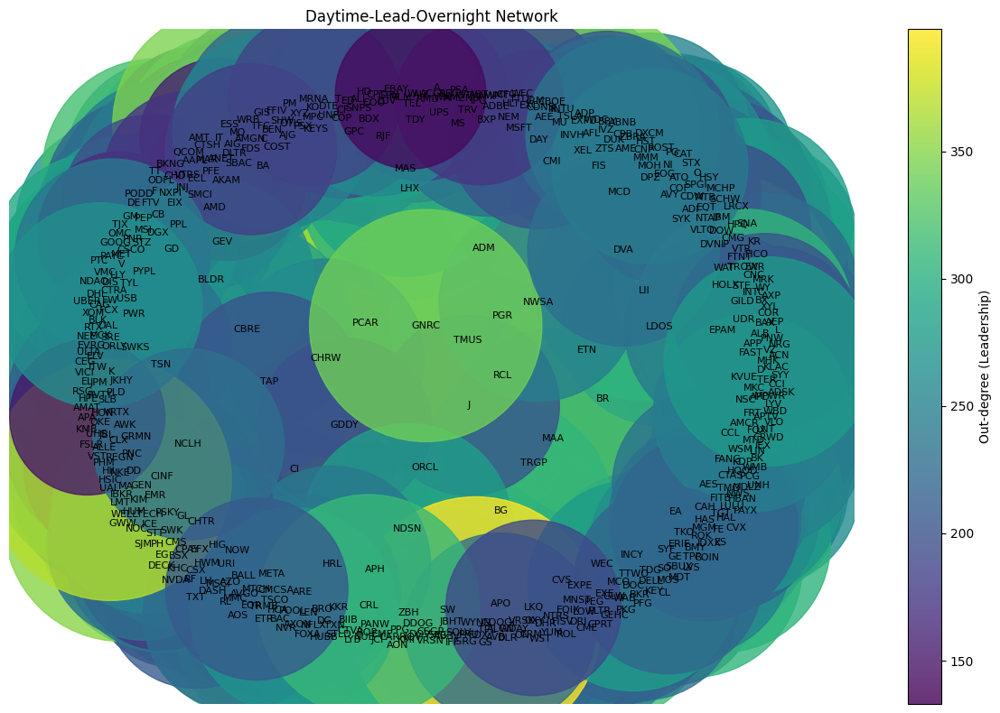

  Nodes: 499
  Edges: 111308
  Density: 0.4479
  Top Leaders: ['WYNN(398)', 'CMI(388)', 'FIS(386)', 'BR(370)', 'HSIC(368)']
  Top Laggers: ['CTAS(436)', 'VRTX(432)', 'DRI(431)', 'FDS(418)', 'MU(417)']

📈 LEAD-LAG PATTERNS



⚖️ ASYMMETRY ANALYSIS:
Overnight-Lead-Daytime:
  Avg |correlation|: 0.1212
  Positive/Negative: 118019/130982
Daytime-Lead-Overnight:
  Avg |correlation|: 0.1071
  Positive/Negative: 127769/121232
🎯 TUG-OF-WAR EVIDENCE: Overnight-lead relationships are stronger!

🔍 DETAILED STATISTICS
💪 STRONGEST LEAD-LAG RELATIONSHIPS:

OL→DT:
  WFC → TRMB: 0.8126 ↑↑
  CRL → TRMB: 0.7949 ↑↑
  BRO → TRMB: 0.7738 ↑↑
  VRSK → GRMN: 0.7703 ↑↑
  L → TRMB: 0.7554 ↑↑

DT→OL:
  TRMB → MCK: 0.8258 ↑↑
  TRMB → APP: 0.7803 ↑↑
  NEM → DLR: -0.7596 ↑↓
  GRMN → EL: -0.7520 ↑↓
  NEM → RMD: -0.7515 ↑↓


AttributeError: 'numpy.ndarray' object has no attribute 'index'

In [9]:
class LeadLagAnalyzer:
    def __init__(self, corr_ol_dt, corr_dt_ol, tickers):
        self.corr_ol_dt = corr_ol_dt
        self.corr_dt_ol = corr_dt_ol
        self.tickers = tickers

    def analyze_all(self, edge_threshold=0.1):
        """Полный анализ аналогичный Streamlit дашборду"""
        print("LEAD-LAG ANALYSIS ===\n")

        # 1. Heatmaps
        self.plot_heatmaps()

        # 2. Network Analysis
        self.analyze_networks(edge_threshold)

        # 3. Lead-Lag Patterns
        self.analyze_patterns()

        # 4. Detailed Statistics
        self.print_detailed_stats()

    def plot_heatmaps(self):
        """Тепловые карты корреляций"""
        print("HEATMAPS")

        fig = make_subplots(
            rows=1, cols=2,
            subplot_titles=("Overnight-Lead-Daytime", "Daytime-Lead-Overnight")
        )

        # Heatmap 1: Overnight-Lead-Daytime
        fig.add_trace(
            go.Heatmap(
                z=self.corr_ol_dt,
                x=self.tickers,
                y=self.tickers,
                colorscale='RdBu_r',
                zmid=0
            ),
            row=1, col=1
        )

        # Heatmap 2: Daytime-Lead-Overnight
        fig.add_trace(
            go.Heatmap(
                z=self.corr_dt_ol,
                x=self.tickers,
                y=self.tickers,
                colorscale='RdBu_r',
                zmid=0
            ),
            row=1, col=2
        )

        fig.update_layout(height=500, title_text="Correlation Matrices")
        fig.show()

        # Статистика по матрицам
        self._print_matrix_stats()

    def _print_matrix_stats(self):
        """Статистика корреляционных матриц"""
        ol_nonzero = self.corr_ol_dt[self.corr_ol_dt != 0]
        dt_nonzero = self.corr_dt_ol[self.corr_dt_ol != 0]

        print(f"\n MATRIX STATISTICS:")
        print(f"Overnight-Lead-Daytime:")
        print(f"  Mean: {np.mean(ol_nonzero):.4f}")
        print(f"  Max:  {np.max(self.corr_ol_dt):.4f}")
        print(f"  Min:  {np.min(self.corr_ol_dt):.4f}")
        print(f"  Std:  {np.std(ol_nonzero):.4f}")

        print(f"Daytime-Lead-Overnight:")
        print(f"  Mean: {np.mean(dt_nonzero):.4f}")
        print(f"  Max:  {np.max(self.corr_dt_ol):.4f}")
        print(f"  Min:  {np.min(self.corr_dt_ol):.4f}")
        print(f"  Std:  {np.std(dt_nonzero):.4f}")

    def analyze_networks(self, threshold=0.1):
        """Анализ сетей"""
        print(f"\n NETWORK ANALYSIS (threshold: {threshold})")

        # Анализ обеих сетей
        for matrix_type, matrix in [("Overnight-Lead-Daytime", self.corr_ol_dt),
                                   ("Daytime-Lead-Overnight", self.corr_dt_ol)]:
            print(f"\n--- {matrix_type} ---")
            G = self._build_network(matrix, threshold)

            if G.number_of_edges() > 0:
                self._plot_network(G, matrix_type)
                self._print_network_stats(G, matrix_type)
            else:
                print("  No significant edges found")

    def _build_network(self, correlation_matrix, threshold):
        """Построение направленного графа"""
        G = nx.DiGraph()

        # Добавляем узлы
        for ticker in self.tickers:
            G.add_node(ticker)

        # Добавляем ребра
        for i in range(len(self.tickers)):
            for j in range(len(self.tickers)):
                if i != j and abs(correlation_matrix[i, j]) > threshold:
                    G.add_edge(self.tickers[i], self.tickers[j],
                              weight=correlation_matrix[i, j])

        return G

    def _plot_network(self, G, title):
        """Визуализация сети"""
        plt.figure(figsize=(12, 8))

        # Позиционирование узлов
        pos = nx.spring_layout(G, k=2, iterations=50)

        # Размер узлов по исходящей степени
        out_degree = dict(G.out_degree())
        node_sizes = [300 + out_degree[node] * 100 for node in G.nodes()]

        # Цвет узлов по исходящей степени
        node_colors = list(out_degree.values())

        # Рисуем ребра
        edge_colors = ['red' if G[u][v]['weight'] < 0 else 'green'
                      for u, v in G.edges()]
        edge_widths = [abs(G[u][v]['weight']) * 3 for u, v in G.edges()]

        nx.draw_networkx_edges(G, pos, edge_color=edge_colors,
                              width=edge_widths, alpha=0.6,
                              arrows=True, arrowsize=20)

        # Рисуем узлы
        nodes = nx.draw_networkx_nodes(G, pos, node_size=node_sizes,
                                     node_color=node_colors,
                                     cmap='viridis', alpha=0.8)

        # Подписи
        nx.draw_networkx_labels(G, pos, font_size=8)

        plt.colorbar(nodes, label='Out-degree (Leadership)')
        plt.title(f'{title} Network')
        plt.axis('off')
        plt.tight_layout()
        plt.show()

    def _print_network_stats(self, G, network_type):
        """Статистика сети"""
        out_degrees = dict(G.out_degree())
        in_degrees = dict(G.in_degree())

        print(f"  Nodes: {G.number_of_nodes()}")
        print(f"  Edges: {G.number_of_edges()}")
        print(f"  Density: {nx.density(G):.4f}")

        # Топ лидеры
        top_leaders = sorted(out_degrees.items(), key=lambda x: x[1], reverse=True)[:5]
        print(f"  Top Leaders: {[f'{ticker}({deg})' for ticker, deg in top_leaders]}")

        # Топ лагеры
        top_laggers = sorted(in_degrees.items(), key=lambda x: x[1], reverse=True)[:5]
        print(f"  Top Laggers: {[f'{ticker}({deg})' for ticker, deg in top_laggers]}")

    def analyze_patterns(self):
        """Анализ паттернов lead-lag"""
        print(f"\n📈 LEAD-LAG PATTERNS")

        # Распределения корреляций
        ol_corrs = self.corr_ol_dt[self.corr_ol_dt != 0].flatten()
        dt_corrs = self.corr_dt_ol[self.corr_dt_ol != 0].flatten()

        fig = make_subplots(rows=1, cols=2, subplot_titles=[
            "Overnight-Lead-Daytime", "Daytime-Lead-Overnight"
        ])

        fig.add_trace(go.Histogram(x=ol_corrs, name="OL→DT", nbinsx=30), row=1, col=1)
        fig.add_trace(go.Histogram(x=dt_corrs, name="DT→OL", nbinsx=30), row=1, col=2)

        fig.update_layout(height=400, title_text="Correlation Distributions")
        fig.show()

        # Асимметрия
        self._print_asymmetry_analysis(ol_corrs, dt_corrs)

    def _print_asymmetry_analysis(self, ol_corrs, dt_corrs):
        """Анализ асимметрии"""
        ol_mean = np.mean(np.abs(ol_corrs))
        dt_mean = np.mean(np.abs(dt_corrs))

        ol_positive = np.sum(ol_corrs > 0)
        ol_negative = np.sum(ol_corrs < 0)
        dt_positive = np.sum(dt_corrs > 0)
        dt_negative = np.sum(dt_corrs < 0)

        print(f"\n ASYMMETRY ANALYSIS:")
        print(f"Overnight-Lead-Daytime:")
        print(f"  Avg |correlation|: {ol_mean:.4f}")
        print(f"  Positive/Negative: {ol_positive}/{ol_negative}")

        print(f"Daytime-Lead-Overnight:")
        print(f"  Avg |correlation|: {dt_mean:.4f}")
        print(f"  Positive/Negative: {dt_positive}/{dt_negative}")

        if ol_mean > dt_mean:
            print(" TUG-OF-WAR EVIDENCE: Overnight-lead relationships are stronger!")
        else:
            print("ℹ Daytime-lead relationships are stronger")

    def print_detailed_stats(self):
        """Детальная статистика"""
        print(f"\n DETAILED STATISTICS")

        # Самые сильные связи
        print(" STRONGEST LEAD-LAG RELATIONSHIPS:")

        for matrix_type, matrix in [("OL→DT", self.corr_ol_dt),
                                   ("DT→OL", self.corr_dt_ol)]:
            print(f"\n{matrix_type}:")
            strong_pairs = []

            for i in range(len(self.tickers)):
                for j in range(len(self.tickers)):
                    if i != j and not np.isnan(matrix[i, j]):
                        strong_pairs.append((self.tickers[i], self.tickers[j], matrix[i, j]))

            # Топ 5 самых сильных связей
            top_pairs = sorted(strong_pairs, key=lambda x: abs(x[2]), reverse=True)[:5]
            for leader, lagger, corr in top_pairs:
                direction = "↑↑" if corr > 0 else "↑↓"
                print(f"  {leader} → {lagger}: {corr:.4f} {direction}")

    def analyze_stock_pair(self, stock1, stock2):
        """Анализ конкретной пары акций"""
        if stock1 not in self.tickers or stock2 not in self.tickers:
            print("Stocks not found in ticker list")
            return

        idx1 = self.tickers.index(stock1)
        idx2 = self.tickers.index(stock2)

        ol_dt_corr = self.corr_ol_dt[idx1, idx2]
        dt_ol_corr = self.corr_dt_ol[idx1, idx2]

        print(f"\n PAIR ANALYSIS: {stock1} vs {stock2}")
        print(f"Overnight {stock1} → Daytime {stock2}: {ol_dt_corr:.4f}")
        print(f"Daytime {stock1} → Overnight {stock2}: {dt_ol_corr:.4f}")

        # Интерпретация
        if abs(ol_dt_corr) > 0.2:
            direction = "positive" if ol_dt_corr > 0 else "negative"
            print(f" Strong {direction} lead-lag relationship detected!")

# ИСПОЛЬЗОВАНИЕ
print("=== LEAD-LAG ANALYSIS STARTING ===")

corr_overnight_daytime, corr_daytime_overnight = calculate_correlations(returns_df, tickers)

# Создаем анализатор
analyzer = LeadLagAnalyzer(corr_overnight_daytime, corr_daytime_overnight, tickers)

analyzer.analyze_all(edge_threshold=0.1)

# # Анализ конкретных пар
# analyzer.analyze_stock_pair('NVDA', 'AAPL')
# analyzer.analyze_stock_pair('MSFT', 'GOOGL')

Heatmap не знаю какие выводы

По  _print_matrix_stats Асимметрия направлений:
 - Overnight→Daytime: -0.0096 (отрицательное)
 - Daytime→Overnight: +0.0034 (положительное)

NETWORK ANALYSIS
  - плотность 50%
  - можем выбрать более высокий порог, 0.1 мало
  - Overnight-Lead-Daytime: если JBL сильный рост ночью, то днем рост TRMB

ночные возвраты действительно являются более сильными лидерами:
OL→DT: 0.1212 vs DT→OL: 0.1071, что соответствует выводам статьи о "информационном преимуществе" ночных периодов

Сетевая структура - обнаружены четкие lead-lag паттерны между разными акциями:
Сильные связи типа WFC → TRMB (0.8126)







# Кластеризация

In [10]:
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler

### d-LE-SC

In [11]:
class DirectedLeadLagClusterer:
    """d-LE-SC алгоритм для обнаружения lead-lag сообществ"""

    def __init__(self, num_iterations=10, initial_eta=0.3):
        self.num_iterations = num_iterations
        self.initial_eta = initial_eta
        self.eta_progression = []
        self.convergence_trace = []

    def identify_communities(self, directed_adjacency_matrix):
        """
        Алгоритм 1: d-LE-SC for lead-lag detection

        Parameters:
        directed_adjacency_matrix: At - направленная матрица смежности

        Returns:
        leader_community, lagger_community - сообщества лидеров и лагеров
        """
        # Шаг 2: Инициализация параметра η
        current_eta = self.initial_eta
        self.eta_progression = [current_eta]

        node_count = directed_adjacency_matrix.shape[0]
        node_indices = np.arange(node_count)

        # Основной цикл (Шаг 3)
        for iteration_idx in range(self.num_iterations):
            print(f"Итерация {iteration_idx + 1}, η = {current_eta:.4f}")

            try:
                # Шаг 4: Вычисление эрмитовой матрицы H
                hermitian_matrix = self._compute_hermitian_matrix(
                    directed_adjacency_matrix, current_eta
                )

                # Шаг 5: Вычисление главного собственного вектора
                primary_eigenvector = self._compute_primary_eigenvector(hermitian_matrix)

                # Шаг 6: Кластеризация на сообщества
                leader_indices, lagger_indices = self._perform_community_clustering(
                    primary_eigenvector, node_indices
                )

                # Шаг 7: Обновление параметра η
                updated_eta = self._update_directed_parameter(
                    directed_adjacency_matrix, leader_indices, lagger_indices
                )

                # Проверка сходимости
                if self._check_parameter_convergence(current_eta, updated_eta):
                    print(f"Сходимость достигнута на итерации {iteration_idx + 1}")
                    break

                current_eta = updated_eta
                self.eta_progression.append(current_eta)

            except Exception as error:
                print(f"Ошибка на итерации {iteration_idx + 1}: {error}")
                # Резервная стратегия: случайное разбиение
                leader_indices, lagger_indices = self._fallback_partition(node_count)
                break

        # Шаг 9: Возвращаем финальные сообщества
        return leader_indices, lagger_indices

    def _compute_hermitian_matrix(self, adjacency_matrix, eta_parameter):
        """Шаг 4: Вычисление эрмитовой матрицы H"""
        # Защита от крайних значений η
        safe_eta = np.clip(eta_parameter, 1e-10, 0.5 - 1e-10)

        # Вычисление коэффициентов
        directional_coeff = 1j * np.log((1 - safe_eta) / safe_eta)
        connectivity_coeff = np.log(1 / (4 * safe_eta * (1 - safe_eta)))

        # Построение матрицы H
        asymmetric_component = adjacency_matrix - adjacency_matrix.T
        symmetric_component = adjacency_matrix + adjacency_matrix.T

        hermitian_matrix = (
            directional_coeff * asymmetric_component +
            connectivity_coeff * symmetric_component
        )

        return hermitian_matrix

    def _compute_primary_eigenvector(self, hermitian_matrix):
        """Шаг 5: Вычисление главного собственного вектора"""
        eigenvalues, eigenvectors = np.linalg.eig(hermitian_matrix)

        # Находим индекс максимального собственного значения (вещественная часть)
        primary_index = np.argmax(np.real(eigenvalues))
        primary_vector = eigenvectors[:, primary_index]

        return primary_vector

    def _perform_community_clustering(self, eigenvector, node_indices):
        """Шаг 6: Кластеризация на два сообщества"""
        # Создаем embedding из вещественной и мнимой частей
        embedding_vectors = np.column_stack([
            np.real(eigenvector),
            np.imag(eigenvector)
        ])

        # K-means кластеризация на 2 сообщества
        from sklearn.cluster import KMeans
        cluster_assigner = KMeans(n_clusters=2, random_state=42, n_init=10)
        community_labels = cluster_assigner.fit_predict(embedding_vectors)

        # Разделяем на два сообщества
        first_community = node_indices[community_labels == 0]
        second_community = node_indices[community_labels == 1]

        return first_community, second_community

    def _update_directed_parameter(self, adjacency_matrix, community_A, community_B):
        """Шаг 7: Обновление параметра направленности η"""
        if len(community_A) == 0 or len(community_B) == 0:
            return self.initial_eta

        # Вычисляем направленные потоки
        flow_A_to_B = self._compute_directional_flow(adjacency_matrix, community_A, community_B)
        flow_B_to_A = self._compute_directional_flow(adjacency_matrix, community_B, community_A)

        total_flow = flow_A_to_B + flow_B_to_A

        if total_flow == 0:
            return self.initial_eta

        # Вычисляем новое η согласно алгоритму
        eta_AB = flow_A_to_B / total_flow
        eta_BA = flow_B_to_A / total_flow

        updated_eta = min(eta_AB, eta_BA)

        # Ограничиваем значения для стабильности
        return np.clip(updated_eta, 0.01, 0.49)

    def _compute_directional_flow(self, adjacency_matrix, source_community, target_community):
        """Вычисление направленного потока между сообществами"""
        total_flow = 0.0

        for source_idx in source_community:
            for target_idx in target_community:
                total_flow += adjacency_matrix[source_idx, target_idx]

        return total_flow

    def _check_parameter_convergence(self, previous_eta, current_eta, tolerance=1e-4):
        """Проверка сходимости параметра η"""
        return abs(current_eta - previous_eta) < tolerance

    def _fallback_partition(self, total_nodes):
        """Резервная стратегия разбиения"""
        node_indices = np.arange(total_nodes)
        split_point = total_nodes // 2
        return node_indices[:split_point], node_indices[split_point:]

    def analyze_convergence(self):
        """Анализ сходимости алгоритма"""
        if len(self.eta_progression) > 1:
            print("Динамика параметра η:")
            for i, eta_val in enumerate(self.eta_progression):
                print(f"  Итерация {i}: η = {eta_val:.4f}")


In [15]:
adjacency_matrix = np.abs(corr_overnight_daytime)
# Заполняем диагональ нулями (нет петель)
np.fill_diagonal(adjacency_matrix, 0)

community_detector = DirectedLeadLagClusterer(num_iterations=8, initial_eta=0.25)
leaders, laggers = community_detector.identify_communities(adjacency_matrix)

print(f"\nРезультаты кластеризации:")
print(f"Сообщество лидеров: {len(leaders)} узлов")
print(f"Сообщество лагеров: {len(laggers)} узлов")

# Анализ сходимости
community_detector.analyze_convergence()

Итерация 1, η = 0.2500
Итерация 2, η = 0.3769
Итерация 3, η = 0.3753
Итерация 4, η = 0.3750
Сходимость достигнута на итерации 4

Результаты кластеризации:
Сообщество лидеров: 363 узлов
Сообщество лагеров: 136 узлов
Динамика параметра η:
  Итерация 0: η = 0.2500
  Итерация 1: η = 0.3769
  Итерация 2: η = 0.3753
  Итерация 3: η = 0.3750


probability_lead_to_lag = 1 - η = 0.625  # 62.5%

probability_lag_to_lead = η = 0.375       # 37.5%

Ребра ОТ лидеров К лагерам: 62.5% (сильное направление)

Ребра ОТ лагеров К лидерам: 37.5% (слабое направление)